In [0]:
import pyspark
from pyspark.sql import functions as f
import pyspark.sql.types as T 
import requests
from datetime import datetime, date, timedelta
from dateutil.relativedelta import relativedelta
import json
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
import numpy as np
import matplotlib.pyplot as plt
import pickle

In [0]:
sc = spark.sparkContext

##Leitura dos dados

In [0]:
df = spark.read.options(delimiter=',', header=True, inferSchema=True).csv("/FileStore/tables/airports_database.csv")
df

Out[3]: DataFrame[id: int, year: int, month: int, day: int, dep_time: double, sched_dep_time: int, dep_delay: double, arr_time: double, sched_arr_time: int, arr_delay: double, carrier: string, flight: int, tailnum: string, origin: string, dest: string, air_time: double, distance: int, hour: int, minute: int, time_hour: timestamp, name: string]

In [0]:
# Adiciona o dia da semana no dataframe, para uso posterior

weekday_mapping= {
    '1': 'DOM',
    '2': 'SEG',
    '3': 'TER',
    '4': 'QUA',
    '5': 'QUI',
    '6': 'SEX',
    '7': 'SAB',                                        
}
df = df \
    .withColumn("weekday", f.dayofweek(df.time_hour).cast(T.StringType())) \
    .replace(to_replace=weekday_mapping, subset=['weekday'])

In [0]:
display(df)

id,year,month,day,dep_time,sched_dep_time,dep_delay,arr_time,sched_arr_time,arr_delay,carrier,flight,tailnum,origin,dest,air_time,distance,hour,minute,time_hour,name,weekday
0,2013,1,1,517.0,515,2.0,830.0,819,11.0,UA,1545,N14228,EWR,IAH,227.0,1400,5,15,2013-01-01T05:00:00.000+0000,United Air Lines Inc.,TER
1,2013,1,1,533.0,529,4.0,850.0,830,20.0,UA,1714,N24211,LGA,IAH,227.0,1416,5,29,2013-01-01T05:00:00.000+0000,United Air Lines Inc.,TER
2,2013,1,1,542.0,540,2.0,923.0,850,33.0,AA,1141,N619AA,JFK,MIA,160.0,1089,5,40,2013-01-01T05:00:00.000+0000,American Airlines Inc.,TER
3,2013,1,1,544.0,545,-1.0,1004.0,1022,-18.0,B6,725,N804JB,JFK,BQN,183.0,1576,5,45,2013-01-01T05:00:00.000+0000,JetBlue Airways,TER
4,2013,1,1,554.0,600,-6.0,812.0,837,-25.0,DL,461,N668DN,LGA,ATL,116.0,762,6,0,2013-01-01T06:00:00.000+0000,Delta Air Lines Inc.,TER
5,2013,1,1,554.0,558,-4.0,740.0,728,12.0,UA,1696,N39463,EWR,ORD,150.0,719,5,58,2013-01-01T05:00:00.000+0000,United Air Lines Inc.,TER
6,2013,1,1,555.0,600,-5.0,913.0,854,19.0,B6,507,N516JB,EWR,FLL,158.0,1065,6,0,2013-01-01T06:00:00.000+0000,JetBlue Airways,TER
7,2013,1,1,557.0,600,-3.0,709.0,723,-14.0,EV,5708,N829AS,LGA,IAD,53.0,229,6,0,2013-01-01T06:00:00.000+0000,ExpressJet Airlines Inc.,TER
8,2013,1,1,557.0,600,-3.0,838.0,846,-8.0,B6,79,N593JB,JFK,MCO,140.0,944,6,0,2013-01-01T06:00:00.000+0000,JetBlue Airways,TER
9,2013,1,1,558.0,600,-2.0,753.0,745,8.0,AA,301,N3ALAA,LGA,ORD,138.0,733,6,0,2013-01-01T06:00:00.000+0000,American Airlines Inc.,TER


In [0]:
display(df.describe())

summary,id,year,month,day,dep_time,sched_dep_time,dep_delay,arr_time,sched_arr_time,arr_delay,carrier,flight,tailnum,origin,dest,air_time,distance,hour,minute,name,weekday
count,336776,336776,336776,336776,328521,336776,328521,328063,336776,327346,336776,336776,334264,336776,336776,327346,336776,336776,336776,336776,336776
mean,168387.5,2013.0,6.548509988835309,15.71078699194717,1349.1099473093045,1344.2548400123524,12.639070257304708,1502.0549985825894,1536.380220086942,6.89537675731489,null,1971.9236198541464,null,null,null,150.68646019807787,1039.9126036297123,13.180247404803193,26.23009953203316,null,null
stddev,97219.00146576285,0.0,3.4144572446788914,8.768607101536851,488.28179100116057,467.33575573420916,40.210060892129945,533.2641319903772,497.4571415143949,44.63329169019391,null,1632.4719381393152,null,null,null,93.68830465900975,733.2330333236786,4.661315707848448,19.300845657412882,null,null
min,0,2013,1,1,1.0,106,-43.0,1.0,1,-86.0,9E,1,D942DN,EWR,ABQ,20.0,17,1,0,AirTran Airways Corporation,DOM
max,336775,2013,12,31,2400.0,2359,1301.0,2400.0,2359,1272.0,YV,8500,N9EAMQ,LGA,XNA,695.0,4983,23,59,Virgin America,TER


##Respostas das perguntas

In [0]:
# 1. Qual é o número total de voos no conjunto de dados?
df.select(f.count(df.id)).show()

+---------+
|count(id)|
+---------+
|   336776|
+---------+



In [0]:
# 2. Quantos voos foram cancelados? (Considerando que voos cancelados têm dep_time e arr_time nulos)
df.filter(df.dep_time.isNull() & df.arr_time.isNull()).count()

Out[52]: 8255

In [0]:
# 3. Qual é o atraso médio na partida dos voos (dep_delay)?
df.agg(f.mean(df.dep_delay)).show()

+------------------+
|    avg(dep_delay)|
+------------------+
|12.639070257304708|
+------------------+



In [0]:
# 4. Quais são os 5 aeroportos com maior número de pousos?
df.groupBy(df.dest).agg(f.count(df.dest)).orderBy("count(dest)", ascending=False).show(5)

+----+-----------+
|dest|count(dest)|
+----+-----------+
| ORD|      17283|
| ATL|      17215|
| LAX|      16174|
| BOS|      15508|
| MCO|      14082|
+----+-----------+
only showing top 5 rows



In [0]:
# 5. Qual é a rota mais frequente (par origin-dest)?
df.groupby([df.origin, df.dest]).agg(f.count(df.id)).orderBy("count(id)", ascending=False).show(5)

+------+----+---------+
|origin|dest|count(id)|
+------+----+---------+
|   JFK| LAX|    11262|
|   LGA| ATL|    10263|
|   LGA| ORD|     8857|
|   JFK| SFO|     8204|
|   LGA| CLT|     6168|
+------+----+---------+
only showing top 5 rows



In [0]:
# 6. Quais são as 5 companhias aéreas com maior tempo médio de atraso na chegada? (Exiba também o tempo)

df.groupBy(df.carrier).agg(f.mean(df.arr_delay)).orderBy("avg(arr_delay)", ascending=False).show(5)


+-------+------------------+
|carrier|    avg(arr_delay)|
+-------+------------------+
|     F9|21.920704845814978|
|     FL|20.115905511811025|
|     EV| 15.79643108710965|
|     YV|15.556985294117647|
|     OO|11.931034482758621|
+-------+------------------+
only showing top 5 rows



In [0]:
df.groupBy(df.name).agg(f.mean(df.arr_delay)).orderBy("avg(arr_delay)", ascending=False).show(5)

+--------------------+------------------+
|                name|    avg(arr_delay)|
+--------------------+------------------+
|Frontier Airlines...|21.920704845814978|
|AirTran Airways C...|20.115905511811025|
|ExpressJet Airlin...| 15.79643108710965|
|  Mesa Airlines Inc.|15.556985294117647|
|SkyWest Airlines ...|11.931034482758621|
+--------------------+------------------+
only showing top 5 rows



In [0]:
# 7. Qual é o dia da semana com maior número de voos?

df.groupBy(df.weekday).agg(f.count(df.id)).orderBy("count(id)", ascending=False).show()

+-------+---------+
|weekday|count(id)|
+-------+---------+
|    SEG|    50690|
|    TER|    50422|
|    SEX|    50308|
|    QUI|    50219|
|    QUA|    50060|
|    DOM|    46357|
|    SAB|    38720|
+-------+---------+



In [0]:
# 8. Qual o percentual mensal dos voos tiveram atraso na partida superior a 30 minutos?

df.groupBy(df.month) \
    .agg(f.count(df.dep_delay).alias("total_count")) \
    .join(
        df.filter(df.dep_delay > 30) \
            .groupBy(df.month) \
            .agg(f.count(df.dep_delay).alias("dep_delay_count")),
        ["month"],
        "left"   
    ).withColumn("percentual", 100 * f.col("dep_delay_count") / f.col("total_count")) \
    .orderBy("month") \
    .show()

+-----+-----------+---------------+------------------+
|month|total_count|dep_delay_count|        percentual|
+-----+-----------+---------------+------------------+
|    1|      26483|           3350|12.649624287278632|
|    2|      23690|           3182|13.431827775432671|
|    3|      27973|           4309|15.404139706145212|
|    4|      27662|           4531|16.379871303593376|
|    5|      28233|           4416|15.641270853256827|
|    6|      27234|           5717| 20.99214217522215|
|    7|      28485|           6173| 21.67105494119712|
|    8|      28841|           4238|14.694358725425609|
|    9|      27122|           2419| 8.918958778851117|
|   10|      28653|           2697| 9.412626950057586|
|   11|      27035|           2388| 8.832994266691326|
|   12|      27110|           4871|17.967539653264478|
+-----+-----------+---------------+------------------+



In [0]:
# 9. Qual a origem mais comum para voos que pousaram em Seattle (SEA)?
df.filter(df.dest == 'SEA').groupBy(df.origin).agg(f.count(df.origin)).orderBy("count(origin)", ascending=False).show()

+------+-------------+
|origin|count(origin)|
+------+-------------+
|   JFK|         2092|
|   EWR|         1831|
+------+-------------+



In [0]:
# 10. Qual é a média de atraso na partida dos voos (dep_delay) para cada dia da semana?

print("Dias com maiores médias de atrasos na partida")
df.groupBy(df.weekday).agg(f.mean(df.dep_delay)).orderBy("avg(dep_delay)", ascending=False).show()

Dias com maiores médias de atrasos na partida
+-------+------------------+
|weekday|    avg(dep_delay)|
+-------+------------------+
|    QUI|16.148919990957108|
|    SEG|14.778936729330908|
|    SEX| 14.69605749486653|
|    QUA|11.803512219083876|
|    DOM|11.589531801152422|
|    TER|10.631682565455652|
|    SAB| 7.650502333676133|
+-------+------------------+



In [0]:
print("Dias com maiores médias de atrasos na chegada")
df.groupBy(df.weekday).agg(f.mean(df.arr_delay)).orderBy("avg(arr_delay)", ascending=False).show()

Dias com maiores médias de atrasos na chegada
+-------+-------------------+
|weekday|     avg(arr_delay)|
+-------+-------------------+
|    QUI| 11.740819486015068|
|    SEG|  9.653739275065414|
|    SEX|  9.070120129401825|
|    QUA| 7.0511186050337225|
|    TER|  5.388525958035696|
|    DOM|  4.820023733134092|
|    SAB|-1.4488278562734827|
+-------+-------------------+



In [0]:
# 11. Qual é a rota que teve o maior tempo de voo médio (air_time)?
df.groupby([df.origin, df.dest]).agg(f.mean(df.air_time)).orderBy("avg(air_time)", ascending=False).show()

+------+----+------------------+
|origin|dest|     avg(air_time)|
+------+----+------------------+
|   JFK| HNL| 623.0877192982456|
|   EWR| HNL|  612.075208913649|
|   EWR| ANC|           413.125|
|   JFK| SFO| 347.4036256011839|
|   JFK| SJC| 346.6067073170732|
|   JFK| OAK| 344.7346278317152|
|   EWR| SFO|342.92812006319116|
|   JFK| SMF| 336.3723404255319|
|   JFK| BUR| 334.1027027027027|
|   JFK| PSP|332.72222222222223|
|   JFK| PDX|330.91014120667523|
|   JFK| LGB| 329.8593040847201|
|   EWR| PDX| 329.4404973357016|
|   JFK| SEA| 329.3744578313253|
|   EWR| SNA| 329.2894088669951|
|   JFK| LAX| 329.1510888072408|
|   EWR| SEA| 325.8767955801105|
|   EWR| LAX|325.75981097185127|
|   JFK| SAN|325.70959595959596|
|   EWR| SAN|325.28622222222225|
+------+----+------------------+
only showing top 20 rows



In [0]:
# 12. Para cada aeroporto de origem, qual é o aeroporto de destino mais comum?

# (resposta abaixo na questão 17)

In [0]:
# 13. Quais são as 3 rotas que tiveram a maior variação no tempo médio de voo (air_time) ?
display(df.groupBy([df.origin, df.dest]).agg(f.mean(df.air_time), f.stddev(df.air_time)).orderBy("stddev_samp(air_time)", ascending=False))

origin,dest,avg(air_time),stddev_samp(air_time)
LGA,MYR,93.33333333333333,25.32455988429677
EWR,HNL,612.075208913649,21.266135468474193
JFK,HNL,623.0877192982456,20.688824842787028
EWR,SNA,329.2894088669951,19.88961488854466
EWR,OKC,193.0095238095238,19.30784562396237
JFK,ABQ,249.16929133858267,19.291371074000587
JFK,SAN,325.70959595959596,19.189950750788768
EWR,SAN,325.28622222222225,19.163369482760007
JFK,EGE,256.44554455445547,18.658764829176
EWR,PHX,290.15493482309125,18.644445031140542


In [0]:
#14. Qual é a média de atraso na chegada para voos que tiveram atraso na partida superior a 1 hora?
df.filter(df.dep_delay > 60).agg(f.mean(df.arr_delay)).show()

+------------------+
|    avg(arr_delay)|
+------------------+
|119.04880549963919|
+------------------+



In [0]:
# 15. Qual é a média de voos diários para cada mês do ano?

df.groupBy(df.month) \
    .agg(f.count(df.id), f.max(df.day)) \
    .withColumn("count per day", f.col("count(id)") / f.col("max(day)")) \
    .orderBy(df.month) \
    .show()

# max(df.day) é o número de dias para aquele mês    
# total de voos no mês dividido pelo número de dias do mês é igual média de voos por dia naquele mês

+-----+---------+--------+-----------------+
|month|count(id)|max(day)|    count per day|
+-----+---------+--------+-----------------+
|    1|    27004|      31|871.0967741935484|
|    2|    24951|      28|891.1071428571429|
|    3|    28834|      31|930.1290322580645|
|    4|    28330|      30|944.3333333333334|
|    5|    28796|      31|928.9032258064516|
|    6|    28243|      30|941.4333333333333|
|    7|    29425|      31|949.1935483870968|
|    8|    29327|      31|946.0322580645161|
|    9|    27574|      30|919.1333333333333|
|   10|    28889|      31|931.9032258064516|
|   11|    27268|      30|908.9333333333333|
|   12|    28135|      31|907.5806451612904|
+-----+---------+--------+-----------------+



In [0]:

# 16. Quais são as 3 rotas mais comuns que tiveram atrasos na chegada superiores a 30 minutos?

df.filter(df.arr_delay > 30)\
    .groupby([df.origin, df.dest])\
    .agg(f.count(df.id).alias("Num de voos atrasados (>30min)"))\
    .orderBy("Num de voos atrasados (>30min)", ascending=False)\
    .show(3)

+------+----+------------------------------+
|origin|dest|Num de voos atrasados (>30min)|
+------+----+------------------------------+
|   LGA| ATL|                          1563|
|   JFK| LAX|                          1286|
|   LGA| ORD|                          1188|
+------+----+------------------------------+
only showing top 3 rows



In [0]:
# 17. Para cada origem, qual o principal destino?

# contagem de voos para cada origem e destino
df.groupBy([df.origin, df.dest]).agg(f.count(df.id)).show()

+------+----+---------+
|origin|dest|count(id)|
+------+----+---------+
|   EWR| STT|      189|
|   JFK| ORD|     2326|
|   JFK| SRQ|      474|
|   JFK| BTV|     1364|
|   EWR| CMH|      724|
|   JFK| ORF|      746|
|   LGA| DSM|      158|
|   LGA| PWM|      278|
|   JFK| MIA|     3314|
|   EWR| TPA|     2334|
|   EWR| DAY|     1134|
|   EWR| BWI|      545|
|   LGA| CVG|      271|
|   LGA| ORF|      206|
|   EWR| SAV|      736|
|   EWR| JAX|     1242|
|   LGA| BNA|     3267|
|   EWR| FLL|     3793|
|   EWR| SAN|     1134|
|   EWR| STL|     2516|
+------+----+---------+
only showing top 20 rows



In [0]:
# número de voos para o destino mais comum de cada origem, mas sem mostrar qual o destino
df.groupBy([df.origin, df.dest]).agg(f.count(df.id)).groupBy("origin").agg(f.max("count(id)")).show()

+------+--------------+
|origin|max(count(id))|
+------+--------------+
|   LGA|         10263|
|   EWR|          6100|
|   JFK|         11262|
+------+--------------+



In [0]:
# Faz o join entre as duas tabelas para mostrar qual o destino correspondente ao maior número de voos de cada origem

df.groupBy([df.origin, df.dest]) \
    .agg(f.count(df.id)) \
    .groupBy("origin") \
    .agg(f.max("count(id)")) \
    .select(
        f.col("origin").alias("t1_origin"),
        f.col("max(count(id))").alias("t1_count")
    ) \
    .join (
        df.groupBy([df.origin, df.dest]) \
            .agg(f.count(df.id)),
        (f.col("origin") == f.col("t1_origin")) & (f.col("count(id)") == f.col("t1_count")),
        "left"                 
).select("origin", "dest", "count(id)").show()


+------+----+---------+
|origin|dest|count(id)|
+------+----+---------+
|   LGA| ATL|    10263|
|   EWR| ORD|     6100|
|   JFK| LAX|    11262|
+------+----+---------+



##Dados API AirportDB

In [0]:
def get_lat_long(airport_code):
    # Busca a latitude e longitude do aeroporto, baseado no seu código internacional
    # Utiliza a API do AirportDB

    # colocar key em arquivo
    airportdb_key = 'dcb3b30445709d2fa0459218357fb68e4950e8db10f5e1f94f61611d840ecde63192977a595d9c679e9835da931471b9'
    url = f"https://airportdb.io/api/v1/airport/K{airport_code}?apiToken={airportdb_key}"
    response = requests.get(url)
    data = response.json()
    status_code = response.status_code

    if status_code != 200:
        return None, status_code

    if airport_code != data["local_code"]:
        raise Exception(f"Requested airport code '{airport_code}' is different from response airport code '{data['local_code']}'")

    return {
        "latitude": data["latitude_deg"],
        "longitude": data["longitude_deg"]
    }, status_code

In [0]:
all_origins = list(df.select(df.origin).distinct().toPandas()["origin"])
all_dests = list(df.select(df.dest).distinct().toPandas()["dest"])
all_airports = list(set(all_origins).union(set(all_dests)))
print(all_origins)
print(all_dests)
print()
print(all_airports)

['LGA', 'EWR', 'JFK']
['PSE', 'MSY', 'SNA', 'BUR', 'GRR', 'MYR', 'GSO', 'PVD', 'OAK', 'MSN', 'DCA', 'ORF', 'CRW', 'SAV', 'CMH', 'CAK', 'IAH', 'HNL', 'CVG', 'SJC', 'BUF', 'AUS', 'SJU', 'AVL', 'LGB', 'SRQ', 'EYW', 'SBN', 'JAC', 'CHS', 'RSW', 'TUL', 'BOS', 'LAS', 'XNA', 'DEN', 'ALB', 'IAD', 'PSP', 'SEA', 'MCI', 'CLT', 'BNA', 'PBI', 'ABQ', 'SDF', 'BDL', 'CLE', 'PDX', 'ACK', 'MIA', 'TPA', 'BWI', 'OKC', 'SMF', 'PHX', 'STL', 'PWM', 'DFW', 'MHT', 'GSP', 'HDN', 'EGE', 'SFO', 'MEM', 'BHM', 'ATL', 'FLL', 'RIC', 'DAY', 'OMA', 'MVY', 'CAE', 'ORD', 'BTV', 'ILM', 'BQN', 'RDU', 'MKE', 'SYR', 'PIT', 'MTJ', 'MDW', 'IND', 'DTW', 'HOU', 'TYS', 'JAX', 'LAX', 'MSP', 'BGR', 'MCO', 'ROC', 'SAN', 'BZN', 'PHL', 'DSM', 'SLC', 'SAT', 'STT', 'LEX', 'CHO', 'LGA', 'TVC', 'ANC']

['ORF', 'HOU', 'JFK', 'TPA', 'ALB', 'AVL', 'GSO', 'PBI', 'DAY', 'SLC', 'JAC', 'BHM', 'SEA', 'BGR', 'DTW', 'TYS', 'DSM', 'PDX', 'ACK', 'DCA', 'RDU', 'BNA', 'PHL', 'MSY', 'PIT', 'OKC', 'HDN', 'MKE', 'SMF', 'SJC', 'IAH', 'MCO', 'DFW', 'IAD', 'C

In [0]:
# Faz a requisição para a API e armazena as latitudes e longitudes de cada aeroporto em um dicionário
airports_location = {}
for idx, airport in enumerate(all_airports):
    print(f"{airport} ({idx+1}/{len(all_airports)})")
    try:
        location, status_code = get_lat_long(airport)
        airports_location[airport] = location
        print(status_code)
    except Exception as e:
        print(e)
airports_location

In [0]:
# Salva em arquivo para não precisar fazer o processo novamente

#dbutils.fs.put("/FileStore/airports_location.json", json.dumps(airports_location, indent=4))

In [0]:
airports_location = json.loads(dbutils.fs.head("/FileStore/airports_location.json"))
airports_location

Out[32]: {'ORF': {'latitude': 36.89459991455078, 'longitude': -76.20120239257812},
 'HOU': {'latitude': 29.64539909, 'longitude': -95.27890015},
 'JFK': {'latitude': 40.639801, 'longitude': -73.7789},
 'TPA': {'latitude': 27.975500106811523, 'longitude': -82.533203125},
 'ALB': {'latitude': 42.74829864501953, 'longitude': -73.80169677734375},
 'AVL': {'latitude': 35.436199, 'longitude': -82.541801},
 'GSO': {'latitude': 36.097801208496094, 'longitude': -79.93730163574219},
 'PBI': {'latitude': 26.68320083618164, 'longitude': -80.09559631347656},
 'DAY': {'latitude': 39.902400970458984, 'longitude': -84.21939849853516},
 'SLC': {'latitude': 40.785749, 'longitude': -111.979746},
 'JAC': {'latitude': 43.6072998046875, 'longitude': -110.73799896240234},
 'BHM': {'latitude': 33.56290054, 'longitude': -86.75350189},
 'SEA': {'latitude': 47.449001, 'longitude': -122.308998},
 'BGR': {'latitude': 44.80739974975586, 'longitude': -68.8281021118164},
 'DTW': {'latitude': 42.212398529052734, 'long

##Dados API WeatherBit

In [0]:
def get_weather_info(latitude, longitude, start_date, end_date):
    # Busca informações do clima em determinado local (latitude, longitude), para o período de datas especificado, com precisão de hora em hora

    #weatherbit_key = '510bd58f3bf14f1bb747d06d2ad2894c'
    weatherbit_key = 'd9ef64625b6a4bc4a723273afb640cfe'
    print(weatherbit_key)
    url = 'http://api.weatherbit.io/v2.0/history/hourly'
    params = {
        'lat': latitude,
        'lon': longitude,
        'start_date': start_date,
        'end_date': end_date,
        'key': weatherbit_key,
        'tz': 'local'
    }
    headers = {
        'Accept': 'application/json',
    }
    response = requests.get(url, params=params, headers=headers)
    status_code = response.status_code

    if status_code != 200:
        return None, status_code

    data = response.json()    
    
    #if data["lat"] != latitude:
    #    raise Exception(f"Requested latitude '{latitude}' is different from response latitude '{data['lat']}'")
    #if data["lon"] != longitude:
    #    raise Exception(f"Requested longitude '{longitude}' is different from response longitude '{data['lon']}'")    

    info_keys = ['wind_spd', 'temp', 'clouds', 'vis', 'precip', 'snow']
    info_filtered = {}
    for info in data["data"]:
        info_filtered[info["timestamp_local"]] = {k: v for k, v in info.items() if k in info_keys}

    return info_filtered, status_code
    

In [0]:
def file_already_exists(filename):
    try:
        if len(dbutils.fs.ls(filename)) > 0:
            return True
    except Exception:
        pass
    return False

In [0]:
len(dbutils.fs.ls("/FileStore/weather/"))

Out[25]: 348

In [0]:
len(all_airports)

Out[11]: 107

In [0]:
    # Para cada mês do ano, e para cada aeroporto, faz a requisição do mês todo de dados do clima
    # Armazena esses dados em arquivos json
    
    year = 2013
    for month in range(1, 12):
        print()
        print(f"Mês: {month}")
        base_datetime = date(day=1, month=month, year=year)
        start_date = base_datetime.strftime("%Y-%m-%d")
        end_date = (base_datetime + relativedelta(months=1)).strftime("%Y-%m-%d")
        print(start_date)
        print(end_date)
        for airport_code in all_airports:

            filename = f"/FileStore/weather/hist-{month}-{year}-{airport_code}.json"
            if file_already_exists(filename):
                print(f"Already got data for this date for the airport {airport_code}. Skipping.")
                continue

            if airports_location.get(airport_code) is None:
                print(f"No location info for the airport {airport_code}")
                continue

            latitude = airports_location[airport_code]["latitude"]
            longitude = airports_location[airport_code]["longitude"]
            print(f"airport_code: {airport_code} ({latitude}, {longitude})")
            weather_info, status_code = get_weather_info(latitude, longitude, start_date, end_date)
            if status_code == 200:
                dbutils.fs.put(filename, json.dumps(weather_info, indent=4))
            elif status_code == 429:
                raise Exception("Too many requests. Aborting")
            else:
                print(f"Returned status code {status_code}")






Mês: 1
2013-01-01
2013-02-01
Already got data for this date for the airport ORF. Skipping.
Already got data for this date for the airport HOU. Skipping.
Already got data for this date for the airport JFK. Skipping.
Already got data for this date for the airport TPA. Skipping.
Already got data for this date for the airport ALB. Skipping.
Already got data for this date for the airport AVL. Skipping.
Already got data for this date for the airport GSO. Skipping.
Already got data for this date for the airport PBI. Skipping.
Already got data for this date for the airport DAY. Skipping.
Already got data for this date for the airport SLC. Skipping.
Already got data for this date for the airport JAC. Skipping.
Already got data for this date for the airport BHM. Skipping.
Already got data for this date for the airport SEA. Skipping.
Already got data for this date for the airport BGR. Skipping.
Already got data for this date for the airport DTW. Skipping.
Already got data for this date for the a

---------------------------------------------------------------------------
Exception                                 Traceback (most recent call last)
File <command-4299220448507174>:28
     26     dbutils.fs.put(filename, json.dumps(weather_info, indent=4))
     27 elif status_code == 429:
---> 28     raise Exception("Too many requests. Aborting")
     29 else:
     30     print(f"Returned status code {status_code}")

Exception: Too many requests. Aborting

In [0]:
# como tem mais de 300 mil linhas no dataframe, e o limite de requisições do weatherbit é de 1500 por dia, não da para fazer uma requisição para cada linha

# de acordo com a documentação, pode ser requisitado 1 mês de dados por request, o que vai ser considerado como 3 requests (1 por cada 10 dias)

In [0]:
# quantidade de aeroportos distintos
len(all_airports)

Out[65]: 107

In [0]:
# um ano completo de dados
df.select(df.month, df.day).distinct().count()

Out[66]: 365

In [0]:
#Considerando 1 requisição para mes, para cada aeroporto (sabendo que a requisição de 1 mês é considerada como 3 requisições)
print(f"Quantidade de requisições necessárias = {12*3*len(all_airports)}")

Quantidade de requisições necessárias = 3852


In [0]:
# a maioria dos aeroportos aparece em mais de um mês
display(df.groupBy(df.dest).agg(f.count(df.id)).orderBy("count(id)"))

dest,count(id)
LEX,1
LGA,1
ANC,8
SBN,10
HDN,15
MTJ,15
EYW,17
PSP,19
JAC,25
BZN,36


##Concatena dados do clima com o DataFrame original

In [0]:
# Tentativas de utilizar o withColumns para concatenar os dados do clima (não deu certo)

In [0]:
def get_weather_from_db(airport_code, date_hour, columns):
    print(airport_code, date_hour)
    filename = f"/FileStore/weather/hist-{date_hour.month}-{date_hour.year}-{airport_code}.json"
    #print(filename)
    
    try:
        weather_info = json.loads(dbutils.fs.head(filename, 1048576)) #1MB
    except Exception as e:
        return [None] * len(columns)
    
    weather_info = weather_info.get(date_hour.isoformat())
    if weather_info is None:
        return [None] * len(columns)
    
    weather_info = [weather_info.get(c) for c in columns]
    return weather_info

In [0]:
get_weather_from_db("SJC", datetime.fromisoformat("2013-02-10T05:00:00.000"), columns=['wind_spd', 'clouds', 'vis', 'test'])

In [0]:
get_weather_from_db("ABC", datetime.fromisoformat("2013-02-10T05:00:00.000"), columns=['wind_spd', 'clouds', 'vis'])

In [0]:
df_weather = df.withColumns(
    get_weather_from_db(df.origin, df.time_hour,
                        columns=['wind_spd', 'clouds', 'vis'],
                        prefix="origin"
    )
)

In [0]:
def test_func(x, y):
    print(x, y)
    return {"minute_test": x + 1, "origin_test": y}

In [0]:
schema = T.StructType([
    T.StructField("minute_test", T.IntegerType(), True),
    T.StructField("origin_test", T.StringType(), True)
])

In [0]:
test_func_2 = f.udf(lambda x, y: [x+1, y+"_abc"], schema) 

In [0]:
display(
    df.select(df["*"],
        test_func_2(df.minute, df.origin).alias("weather")
    ).select(df["*"], "weather.minute_test", "weather.origin_test")
)

In [0]:
weather_schema = T.StructType([
    T.StructField("wind_spd", T.FloatType(), True),
    T.StructField("clouds", T.FloatType(), True),
    T.StructField("vis", T.FloatType(), True),
])

In [0]:
weather_func = f.udf(
    lambda airport_code, date_hour:
    get_weather_from_db(airport_code, date_hour, columns=['wind_spd', 'clouds', 'vis']), weather_schema
) 

In [0]:
display(
    df.select(df["*"],
        weather_func(df.origin, df.time_hour).alias("origin")
    )
)

In [0]:
display(df_weather)

In [0]:
# Ao invés de utilizar o withColumns, centraliza todos os dados de clima em um dataframe separado
# Em seguida, realiza o join do dataframe original com esse dataframe separado, tanto para a origem quanto para o destino

In [0]:
# Insere todos os dados do clima salvos em json em um novo dataframe

all_files = dbutils.fs.ls("/FileStore/weather/")
weather_list = []
for filename in all_files:
    print(filename.path)
    airport_code = filename.name.split(".")[0].split("-")[-1]
    print(airport_code)

    weather_info = json.loads(dbutils.fs.head(filename.path, 1048576)) #1MB
    for k, v in weather_info.items():
        weather_list.append(
            [
                airport_code,
                datetime.fromisoformat(k),
                float(v["wind_spd"]) if v.get("wind_spd") is not None else None,
                float(v["clouds"]) if v.get("clouds") is not None else None,
                float(v["vis"]) if v.get("vis") is not None else None
            ]
        )

weather_df = spark.createDataFrame(weather_list, ['airport_code', 'datetime', 'wind_spd', 'clouds', 'vis'])

del(weather_list)

display(weather_df)

dbfs:/FileStore/weather/hist-1-2013-ABQ.json
ABQ
dbfs:/FileStore/weather/hist-1-2013-ACK.json
ACK
dbfs:/FileStore/weather/hist-1-2013-ALB.json
ALB
dbfs:/FileStore/weather/hist-1-2013-ATL.json
ATL
dbfs:/FileStore/weather/hist-1-2013-AUS.json
AUS
dbfs:/FileStore/weather/hist-1-2013-AVL.json
AVL
dbfs:/FileStore/weather/hist-1-2013-BDL.json
BDL
dbfs:/FileStore/weather/hist-1-2013-BGR.json
BGR
dbfs:/FileStore/weather/hist-1-2013-BHM.json
BHM
dbfs:/FileStore/weather/hist-1-2013-BNA.json
BNA
dbfs:/FileStore/weather/hist-1-2013-BOS.json
BOS
dbfs:/FileStore/weather/hist-1-2013-BTV.json
BTV
dbfs:/FileStore/weather/hist-1-2013-BUF.json
BUF
dbfs:/FileStore/weather/hist-1-2013-BUR.json
BUR
dbfs:/FileStore/weather/hist-1-2013-BWI.json
BWI
dbfs:/FileStore/weather/hist-1-2013-BZN.json
BZN
dbfs:/FileStore/weather/hist-1-2013-CAE.json
CAE
dbfs:/FileStore/weather/hist-1-2013-CAK.json
CAK
dbfs:/FileStore/weather/hist-1-2013-CHO.json
CHO
dbfs:/FileStore/weather/hist-1-2013-CHS.json
CHS
dbfs:/FileStore/weat

airport_code,datetime,wind_spd,clouds,vis
ABQ,2013-01-01T00:00:00.000+0000,2.6,50.0,16.0
ABQ,2013-01-01T01:00:00.000+0000,2.97,50.0,16.0
ABQ,2013-01-01T02:00:00.000+0000,4.09,43.0,16.0
ABQ,2013-01-01T03:00:00.000+0000,2.97,31.0,16.0
ABQ,2013-01-01T04:00:00.000+0000,2.47,43.0,16.0
ABQ,2013-01-01T05:00:00.000+0000,2.1,25.0,16.0
ABQ,2013-01-01T06:00:00.000+0000,0.37,31.0,16.0
ABQ,2013-01-01T07:00:00.000+0000,2.02,50.0,16.0
ABQ,2013-01-01T08:00:00.000+0000,3.6,50.0,16.0
ABQ,2013-01-01T09:00:00.000+0000,3.6,50.0,16.0


In [0]:
# Faz o join dos dados do clima no destino
# (clima no destino no horario programado de partida, e não do momento de chegada)
model_df = df.join(
    weather_df.select(
        weather_df.airport_code,
        weather_df.datetime,
        weather_df.wind_spd.alias("dest_wind_spd"),
        weather_df.clouds.alias("dest_clouds"),
        weather_df.vis.alias("dest_vis")
    ),
    (df.dest == weather_df.airport_code) & (df.time_hour == weather_df.datetime),
    "left"
).select(df["*"], "dest_wind_spd", "dest_clouds", "dest_vis")

# Faz o join dos dados do clima na origem, também no horário programado de partida
model_df = model_df.join(
    weather_df.select(
        weather_df.airport_code,
        weather_df.datetime,
        weather_df.wind_spd.alias("origin_wind_spd"),
        weather_df.clouds.alias("origin_clouds"),
        weather_df.vis.alias("origin_vis")
    ),
    (model_df.origin == weather_df.airport_code) & (model_df.time_hour == weather_df.datetime),
    "left"
).select(model_df["*"], "origin_wind_spd", "origin_clouds", "origin_vis")


In [0]:
display(model_df)

id,year,month,day,dep_time,sched_dep_time,dep_delay,arr_time,sched_arr_time,arr_delay,carrier,flight,tailnum,origin,dest,air_time,distance,hour,minute,time_hour,name,weekday,dest_wind_spd,dest_clouds,dest_vis,origin_wind_spd,origin_clouds,origin_vis
232,2013,1,1,1024.0,1030,-6.0,1204.0,1215,-11.0,MQ,4471,N719MQ,LGA,RDU,78.0,431,10,30,2013-01-01T10:00:00.000+0000,Envoy Air,TER,3.22,100.0,12.0,8.19,87.0,16.0
827,2013,1,1,2306.0,2245,21.0,28.0,5,23.0,B6,30,N281JB,JFK,ROC,59.0,264,22,45,2013-01-01T22:00:00.000+0000,JetBlue Airways,TER,3.6,87.0,16.0,9.8,90.0,16.0
1040,2013,1,2,841.0,844,-3.0,955.0,954,1.0,EV,4610,N14972,EWR,SYR,40.0,195,8,44,2013-01-02T08:00:00.000+0000,ExpressJet Airlines Inc.,QUA,9.8,100.0,14.0,3.35,87.0,16.0
1080,2013,1,2,916.0,919,-3.0,1029.0,1030,-1.0,B6,1004,N558JB,JFK,BOS,39.0,187,9,19,2013-01-02T09:00:00.000+0000,JetBlue Airways,QUA,4.59,50.0,16.0,5.7,87.0,16.0
1730,2013,1,2,2100.0,2100,0.0,2240.0,2235,5.0,MQ,4507,N739MQ,LGA,RDU,79.0,431,21,0,2013-01-02T21:00:00.000+0000,Envoy Air,QUA,1.2,100.0,16.0,4.75,87.0,16.0
1759,2013,1,2,2150.0,2155,-5.0,2333.0,2337,-4.0,B6,1109,N239JB,JFK,RDU,83.0,427,21,55,2013-01-02T21:00:00.000+0000,JetBlue Airways,QUA,1.2,100.0,16.0,4.25,87.0,16.0
1992,2013,1,3,857.0,900,-3.0,1137.0,1135,2.0,DL,485,N308DE,EWR,ATL,130.0,746,9,0,2013-01-03T09:00:00.000+0000,Delta Air Lines Inc.,QUI,5.92,100.0,12.0,2.6,87.0,16.0
2022,2013,1,3,923.0,929,-6.0,1210.0,1206,4.0,EV,4140,N15986,EWR,ATL,129.0,746,9,29,2013-01-03T09:00:00.000+0000,ExpressJet Airlines Inc.,QUI,5.92,100.0,12.0,2.6,87.0,16.0
2047,2013,1,3,955.0,955,0.0,1246.0,1220,26.0,MQ,4654,N509MQ,LGA,ATL,133.0,762,9,55,2013-01-03T09:00:00.000+0000,Envoy Air,QUI,5.92,100.0,12.0,3.97,87.0,16.0
2570,2013,1,3,1941.0,1946,-5.0,2200.0,2154,6.0,EV,4304,N15910,EWR,CVG,105.0,569,19,46,2013-01-03T19:00:00.000+0000,ExpressJet Airlines Inc.,QUI,2.6,100.0,16.0,4.59,87.0,16.0


In [0]:
# Salva o novo dataframe em disco
model_df.coalesce(1).write.format("com.databricks.spark.csv").option("header", "true").save("dbfs:/FileStore/tables/model_df/")

In [0]:
# Pergunta final: Enriqueça a base de dados de voos com as condições meteorológicas
# (velocidade do vento) para os aeroportos de origem e destino. Mostre as informações
# enriquecidas para os 5 voos com maior atraso na chegada.
display(
    model_df.select(
        model_df.dep_delay, model_df.arr_delay, model_df.distance,
        model_df.origin_wind_spd, model_df.origin_clouds, model_df.origin_vis,
        model_df.dest_wind_spd, model_df.dest_clouds, model_df.dest_vis
    ).orderBy(model_df.arr_delay, ascending=False).limit(5)
)

dep_delay,arr_delay,distance,origin_wind_spd,origin_clouds,origin_vis,dest_wind_spd,dest_clouds,dest_vis
1301.0,1272.0,4983,0.52,87.0,12.0,null,null,null
1137.0,1127.0,483,5.92,59.0,16.0,3.1,100.0,16.0
1126.0,1109.0,719,4.34,87.0,16.0,6.32,100.0,16.0
1014.0,1007.0,2586,4.97,25.0,16.0,6.2,87.0,16.0
1005.0,989.0,589,4.59,59.0,16.0,3.1,87.0,16.0


In [0]:
display(
    model_df.select(
        model_df.origin_wind_spd, model_df.origin_clouds, model_df.origin_vis,
        model_df.dest_wind_spd, model_df.dest_clouds, model_df.dest_vis
    ).describe()
)

summary,origin_wind_spd,origin_clouds,origin_vis,dest_wind_spd,dest_clouds,dest_vis
count,118410,118410,118410,92738,92738,92738
mean,5.481019846297009,72.85164259775357,14.479123384849252,4.339478423084474,67.82852768013112,14.575050141258169
stddev,2.591963984808542,27.955610198242592,3.7360181602340763,2.3669358919916523,32.61684009420089,3.557837417758506
min,0.0,0.0,0.0,0.0,0.0,0.0
max,16.72,100.0,16.0,26.2,100.0,16.0


In [0]:
# Os voos com maiores atrasos possuem maior velocidade do vento no destino e maior quantidade de nuvens no destino, em comparação ao valor médio dessas variáveis.
# Como os dados do clima foram capturados com o fuso local, eles não refletem exatamente o clima naquele instante de tempo apontado pelo 'time_hour'
# Como o atraso na chegada é bastante influenciado pelo atraso na saída, aqui também é possível filtrar voos que não tiveram atraso muito grande na saída, mas que ainda assim tiveram grande atraso na chegada (valor de arr_delay - dep_delay). Pois isso pode indicar algum problema durante o voo ou durante o pouso, e daria para correlacionar essa informação com as informações do clima no destino.

## Modelo de predição

In [0]:
# modelo usa as condições de clima no momento do horário programado de partida, tanto na origem quanto destino, pois no momento da predição, a API não sabe qual o clima no destino no momento previsto de chegada, apenas no momento de saida.
# Uma possibilidade seria usar a API de forecast do weather bit, mas por conta do tempo de desenvolvimento não fiz essa integração

# Melhorias possíveis no modelo:
# Adicionar o dia da semana (ou variável contendo qual a posíção daquele dia entre os com mais atrasos)
# Adicionar o mês (ou variável contendo qual a posíção daquele mês entre os com mais atrasos)
# Se a rota é uma das que tiveram maior tempo de atraso
# Cometi o erro de coletar os dados do clima referentes ao horário local de cada localização. Como utilizo o horario programado de partida como referência, seria melhor ter utilizado o horário UTC. Eu gostaria de capturar novamente os dados com o fuso correto, mas como o número de requisições é limitado por dia, não houve tempo viável para isso.
# Utilizar informação de qual a companhia aérea
# Utilizar informação de qual o aeroporto de origem
# Carregar mais dados do clima, para poder utilizar mais dados do dataframe
# Testar outros modelos além do Random Forest
# Tuning dos hiperparâmtros do modelo

In [0]:
display(model_df)

id,year,month,day,dep_time,sched_dep_time,dep_delay,arr_time,sched_arr_time,arr_delay,carrier,flight,tailnum,origin,dest,air_time,distance,hour,minute,time_hour,name,dest_wind_spd,dest_clouds,dest_vis,origin_wind_spd,origin_clouds,origin_vis
232,2013,1,1,1024.0,1030,-6.0,1204.0,1215,-11.0,MQ,4471,N719MQ,LGA,RDU,78.0,431,10,30,2013-01-01T10:00:00.000+0000,Envoy Air,3.22,100.0,12.0,8.19,87.0,16.0
827,2013,1,1,2306.0,2245,21.0,28.0,5,23.0,B6,30,N281JB,JFK,ROC,59.0,264,22,45,2013-01-01T22:00:00.000+0000,JetBlue Airways,3.6,87.0,16.0,9.8,90.0,16.0
1040,2013,1,2,841.0,844,-3.0,955.0,954,1.0,EV,4610,N14972,EWR,SYR,40.0,195,8,44,2013-01-02T08:00:00.000+0000,ExpressJet Airlines Inc.,9.8,100.0,14.0,3.35,87.0,16.0
1080,2013,1,2,916.0,919,-3.0,1029.0,1030,-1.0,B6,1004,N558JB,JFK,BOS,39.0,187,9,19,2013-01-02T09:00:00.000+0000,JetBlue Airways,4.59,50.0,16.0,5.7,87.0,16.0
1730,2013,1,2,2100.0,2100,0.0,2240.0,2235,5.0,MQ,4507,N739MQ,LGA,RDU,79.0,431,21,0,2013-01-02T21:00:00.000+0000,Envoy Air,1.2,100.0,16.0,4.75,87.0,16.0
1759,2013,1,2,2150.0,2155,-5.0,2333.0,2337,-4.0,B6,1109,N239JB,JFK,RDU,83.0,427,21,55,2013-01-02T21:00:00.000+0000,JetBlue Airways,1.2,100.0,16.0,4.25,87.0,16.0
1992,2013,1,3,857.0,900,-3.0,1137.0,1135,2.0,DL,485,N308DE,EWR,ATL,130.0,746,9,0,2013-01-03T09:00:00.000+0000,Delta Air Lines Inc.,5.92,100.0,12.0,2.6,87.0,16.0
2022,2013,1,3,923.0,929,-6.0,1210.0,1206,4.0,EV,4140,N15986,EWR,ATL,129.0,746,9,29,2013-01-03T09:00:00.000+0000,ExpressJet Airlines Inc.,5.92,100.0,12.0,2.6,87.0,16.0
2047,2013,1,3,955.0,955,0.0,1246.0,1220,26.0,MQ,4654,N509MQ,LGA,ATL,133.0,762,9,55,2013-01-03T09:00:00.000+0000,Envoy Air,5.92,100.0,12.0,3.97,87.0,16.0
2570,2013,1,3,1941.0,1946,-5.0,2200.0,2154,6.0,EV,4304,N15910,EWR,CVG,105.0,569,19,46,2013-01-03T19:00:00.000+0000,ExpressJet Airlines Inc.,2.6,100.0,16.0,4.59,87.0,16.0


In [0]:
model_df.select(model_df.carrier).distinct().show()

+-------+
|carrier|
+-------+
|     UA|
|     AA|
|     EV|
|     B6|
|     DL|
|     OO|
|     F9|
|     YV|
|     US|
|     MQ|
|     HA|
|     AS|
|     FL|
|     VX|
|     WN|
|     9E|
+-------+



In [0]:
# Distancia e tempo de voo tem alta correlação
# Portanto irei utilizar apenas a distância no modelo
model_df.corr("air_time", "distance")

Out[64]: 0.9642269557972192

In [0]:
# Tempo de atraso de saída tem alta correlação com tempo de atraso de chegada
# Portanto dep_delay é uma boa variavel para predizer arr_delay
model_df.corr("dep_delay", "arr_delay")

Out[66]: 0.9093483343320454

In [0]:
model_df_filtered = model_df.select(
    model_df.dep_delay,
    model_df.distance,
    model_df.origin_wind_spd,
    model_df.origin_clouds,
    model_df.origin_vis,    
    model_df.dest_wind_spd,
    model_df.dest_clouds,
    model_df.dest_vis,
    model_df.arr_delay,
).toPandas()
model_df_filtered = model_df_filtered.dropna()
model_df_filtered

,dep_delay,distance,origin_wind_spd,origin_clouds,origin_vis,dest_wind_spd,dest_clouds,dest_vis,arr_delay
0,-6.0,431,8.19,87.0,16.0,3.22,100.0,12.0,-11.0
1,21.0,264,9.80,90.0,16.0,3.60,87.0,16.0,23.0
2,-3.0,195,3.35,87.0,16.0,9.80,100.0,14.0,1.0
3,-3.0,187,5.70,87.0,16.0,4.59,50.0,16.0,-1.0
4,0.0,431,4.75,87.0,16.0,1.20,100.0,16.0,5.0
...,...,...,...,...,...,...,...,...,...
230700,-1.0,213,7.32,87.0,16.0,4.59,100.0,16.0,13.0
230703,-7.0,1028,6.20,87.0,16.0,7.20,50.0,16.0,-18.0
230709,-2.0,2446,4.34,100.0,16.0,3.60,25.0,14.0,-33.0
230711,-4.0,944,3.60,87.0,16.0,2.60,100.0,8.0,-24.0


In [0]:
X = model_df_filtered.drop("arr_delay", axis=1)
y = model_df_filtered["arr_delay"]
print(list(X.columns))
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)
print(f"Train samples: {len(X_train)}")
print(f"Test samples: {len(X_test)}")

['dep_delay', 'distance', 'origin_wind_spd', 'origin_clouds', 'origin_vis', 'dest_wind_spd', 'dest_clouds', 'dest_vis']
Train samples: 59371
Test samples: 19791


In [0]:
model = RandomForestRegressor()
model.fit(X, y)

Out[70]: RandomForestRegressor()

In [0]:
print(f"R2 do treinamento: {model.score(X_train, y_train)}")
print(f"R2 do teste: {model.score(X_test, y_test)}")

err = model.predict(X_test) - y_test.to_numpy()
print(f"MAE: {np.mean(np.abs(err))}")
print(f"Std Error: {np.std(err)}")
print(f"Max. Abs error: {np.max(np.abs(err))}")

R2 do treinamento: 0.9800023779320997
R2 do teste: 0.9796368457422097
MAE: 4.39510982244615
Std Error: 5.875674896870664
Max. Abs error: 45.81


Out[72]: [<matplotlib.lines.Line2D at 0x7f3f45174490>]

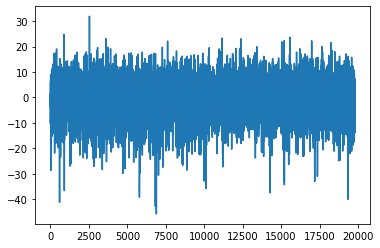

In [0]:
plt.plot(err)

Out[73]: (array([3.000e+00, 5.000e+00, 6.000e+00, 2.200e+01, 7.200e+01, 2.240e+02,
        7.040e+02, 2.648e+03, 6.930e+03, 6.584e+03, 2.157e+03, 3.650e+02,
        6.100e+01, 9.000e+00, 1.000e+00]),
 array([-45.81      , -40.62866667, -35.44733333, -30.266     ,
        -25.08466667, -19.90333333, -14.722     ,  -9.54066667,
         -4.35933333,   0.822     ,   6.00333333,  11.18466667,
         16.366     ,  21.54733333,  26.72866667,  31.91      ]),
 <BarContainer object of 15 artists>)

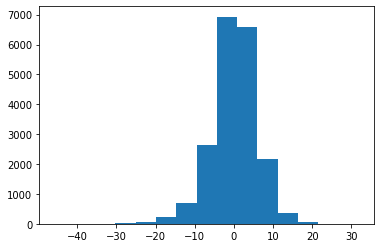

In [0]:
plt.hist(err, bins=15)

In [0]:
# Salva o modelo como pickle

In [0]:
with open('/dbfs/model2.pkl', 'wb') as _file:
    pickle.dump(model, _file, protocol=pickle.HIGHEST_PROTOCOL)
dbutils.fs.cp("file:/dbfs/model2.pkl", "dbfs:/FileStore/models/model2.pkl")    

Out[74]: True

In [0]:
import sklearn
print(sklearn.__version__)
print(np.__version__)

1.0.2
1.21.5


## Análise distância entre aeroportos

In [0]:
# A ideia dessa etapa é guardar a informação de distância entre cada par de origem e destino presentes nos dados históricos. Isso vai possibilitar fazer com que a API receba como input apenas qual a origem e destino, e internamente calcular a distância (média histórica).

In [0]:
df_distance = df.groupBy([df.origin, df.dest]).agg(f.mean(df.distance), f.stddev(df.distance)).orderBy("stddev_samp(distance)", ascending=False)
display(df_distance)

origin,dest,avg(distance),stddev_samp(distance)
EWR,EGE,1725.5363636363636,0.500958214435643
JFK,EGE,1746.5728155339805,0.49708841971148654
JFK,BQN,1576.0,1.8131742445741103E-13
JFK,ORD,740.0,9.118915711593147E-14
EWR,MCO,937.0,9.073964942884647E-14
EWR,PBI,1023.0,8.938644855877232E-14
EWR,DTW,488.0,4.560081890730238E-14
LGA,CRW,444.0,3.9537174025196336E-14
LGA,MEM,963.0,2.879145238142101E-14
EWR,GSO,445.0,1.5690827730558057E-14


In [0]:
# Todas as rotas do histórico tiveram sempre a mesma distância, portanto não houve variação de trajeto entre essas rotas para os dados históricos
# Salvar a média dessa distância entre rotas para posterior uso na API
# Como é um dataframe pequeno, vou tratar utilizando o pandas mesmo, e salvar no formato json

In [0]:
df_distance_pd = df_distance.toPandas()
df_distance_pd

,origin,dest,avg(distance),stddev_samp(distance)
0,EWR,EGE,1725.536364,5.009582e-01
1,JFK,EGE,1746.572816,4.970884e-01
2,JFK,BQN,1576.000000,1.813174e-13
3,JFK,ORD,740.000000,9.118916e-14
4,EWR,MCO,937.000000,9.073965e-14
...,...,...,...,...
219,JFK,MEM,964.000000,NaN
220,LGA,LEX,604.000000,NaN
221,JFK,STL,892.000000,NaN
222,JFK,BHM,865.000000,NaN


In [0]:
distances = {}
for origin in list(df_distance_pd["origin"].unique()):
    distances[origin] = df_distance_pd[df_distance_pd["origin"] == origin] \
        [["dest", "avg(distance)"]] \
        .set_index("dest") \
        .to_dict()["avg(distance)"]
distances

Out[16]: {'EWR': {'EGE': 1725.5363636363636,
  'MCO': 937.0,
  'PBI': 1023.0,
  'DTW': 488.0,
  'GSO': 445.0,
  'ROC': 246.0,
  'STT': 1634.0,
  'CMH': 463.0,
  'TPA': 997.0,
  'DAY': 533.0,
  'BWI': 169.0,
  'SAV': 708.0,
  'JAX': 820.0,
  'FLL': 1065.0,
  'SAN': 2425.0,
  'STL': 872.0,
  'SLC': 1969.0,
  'JAC': 1874.0,
  'PHX': 2133.0,
  'CHS': 628.0,
  'MEM': 946.0,
  'IAH': 1400.0,
  'AVL': 583.0,
  'CAE': 602.0,
  'LAX': 2454.0,
  'PDX': 2434.0,
  'SEA': 2402.0,
  'CLE': 404.0,
  'DSM': 1017.0,
  'DEN': 1605.0,
  'DCA': 199.0,
  'AUS': 1504.0,
  'ORD': 719.0,
  'MYR': 550.0,
  'MSY': 1167.0,
  'ORF': 284.0,
  'TYS': 631.0,
  'MSP': 1008.0,
  'PIT': 319.0,
  'MHT': 209.0,
  'IND': 645.0,
  'HDN': 1728.0,
  'CLT': 529.0,
  'BTV': 266.0,
  'TUL': 1215.0,
  'HOU': 1411.0,
  'SDF': 642.0,
  'IAD': 212.0,
  'XNA': 1131.0,
  'PWM': 284.0,
  'BNA': 748.0,
  'SFO': 2565.0,
  'ATL': 746.0,
  'PVD': 160.0,
  'BOS': 200.0,
  'BQN': 1585.0,
  'LAS': 2227.0,
  'DFW': 1372.0,
  'BZN': 1882.0,
  

In [0]:
dbutils.fs.put("/FileStore/airports_distances.json", json.dumps(distances, indent=4))

Wrote 5098 bytes.
Out[17]: True

##Transferência de arquivos entre file:/ e  dbfs:/

In [0]:
# arquivos acessados pelo dbutils:
# "dbfs:/" -> não aparece no filesystem local. FilesStore fica aqui dentro
# "file:/" -> filesystem local, mesmo acessado pelo open() do python e pelo sh
# da para copiar de uma para o outro com o dbutils.fs.cp

In [0]:
# Zipando arquivos do weather para backup

In [0]:
dbutils.fs.ls("dbfs:/FileStore/weather")

Out[5]: [FileInfo(path='dbfs:/FileStore/weather/hist-1-2013-ABQ.json', name='hist-1-2013-ABQ.json', size=120960, modificationTime=1728643600000),
 FileInfo(path='dbfs:/FileStore/weather/hist-1-2013-ACK.json', name='hist-1-2013-ACK.json', size=121105, modificationTime=1728643590000),
 FileInfo(path='dbfs:/FileStore/weather/hist-1-2013-ALB.json', name='hist-1-2013-ALB.json', size=121455, modificationTime=1728643581000),
 FileInfo(path='dbfs:/FileStore/weather/hist-1-2013-ATL.json', name='hist-1-2013-ATL.json', size=121423, modificationTime=1728643604000),
 FileInfo(path='dbfs:/FileStore/weather/hist-1-2013-AUS.json', name='hist-1-2013-AUS.json', size=121130, modificationTime=1728778001000),
 FileInfo(path='dbfs:/FileStore/weather/hist-1-2013-AVL.json', name='hist-1-2013-AVL.json', size=121048, modificationTime=1728643581000),
 FileInfo(path='dbfs:/FileStore/weather/hist-1-2013-BDL.json', name='hist-1-2013-BDL.json', size=121360, modificationTime=1728770888000),
 FileInfo(path='dbfs:/File

In [0]:
dbutils.fs.cp("dbfs:/FileStore/weather/", "file:/weather", True)    

Out[6]: True

In [0]:
%sh ls /weather

hist-1-2013-ABQ.json
hist-1-2013-ACK.json
hist-1-2013-ALB.json
hist-1-2013-ATL.json
hist-1-2013-AUS.json
hist-1-2013-AVL.json
hist-1-2013-BDL.json
hist-1-2013-BGR.json
hist-1-2013-BHM.json
hist-1-2013-BNA.json
hist-1-2013-BOS.json
hist-1-2013-BTV.json
hist-1-2013-BUF.json
hist-1-2013-BUR.json
hist-1-2013-BWI.json
hist-1-2013-BZN.json
hist-1-2013-CAE.json
hist-1-2013-CAK.json
hist-1-2013-CHO.json
hist-1-2013-CHS.json
hist-1-2013-CLE.json
hist-1-2013-CLT.json
hist-1-2013-CMH.json
hist-1-2013-CRW.json
hist-1-2013-CVG.json
hist-1-2013-DAY.json
hist-1-2013-DCA.json
hist-1-2013-DEN.json
hist-1-2013-DFW.json
hist-1-2013-DSM.json
hist-1-2013-DTW.json
hist-1-2013-EGE.json
hist-1-2013-EWR.json
hist-1-2013-EYW.json
hist-1-2013-FLL.json
hist-1-2013-GRR.json
hist-1-2013-GSO.json
hist-1-2013-GSP.json
hist-1-2013-HDN.json
hist-1-2013-HOU.json
hist-1-2013-IAD.json
hist-1-2013-IAH.json
hist-1-2013-ILM.json
hist-1-2013-IND.json
hist-1-2013-JAC.json
hist-1-2013-JAX.json
hist-1-2013-JFK.json
hist-1-2013-L

In [0]:
%sh tar czf /weather.tar.gz /weather

tar: Removing leading `/' from member names


In [0]:
dbutils.fs.cp("file:/weather.tar.gz", "dbfs:/FileStore/weather.tar.gz")    

Out[9]: True